# Global polynomial interpolation (Lecture 4)

Last time we talked about piecewise linear interpolation, on arbitrary node sets. We showed that, for equispaced nodes , the maximum error ($\infty$ norm) of the interpolant converges quadratically with the node spacing $\Delta x$.

Can we do better than this? Particularly for "smooth" functions? This lecture is about interpolation with **polynomials**, in particular polynomials that have *global support*---i.e., that are defined on the whole input domain.

# Outline of the lecture
- Global polynomial interpolation, in a monomial basis. Finding polynomial coefficients via the Vandermonde matrix.
- Look at errors of the interpolant in various ways. How does it depend on the polynomial degree, the nodal set, and the target function?
- Better nodal sets? Chebyshev points!
- Cardinal functions for global polynomial interpolation: Lagrange interpolating polynomials

# Simple interpolation using the Vandermonde matrix

Recall our function from the last lecture:

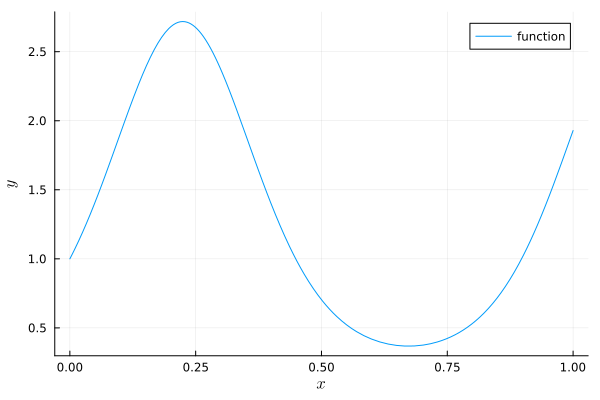

In [1]:
using Plots
using LaTeXStrings

f = x -> exp(sin(7x))

plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")

Interpolate the function using a polynomial of degree $n$:

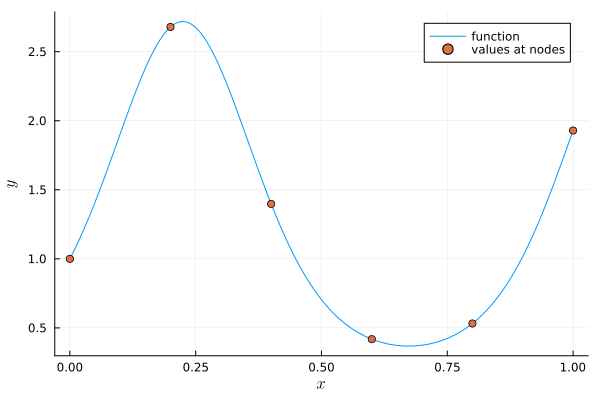

In [2]:
n = 5
t = range(0,1,n+1)
y = f.(t)
scatter!(t, y, label="values at nodes")

In [3]:
M = t .^ (0:n)' # the Vandermonde matrix

6×6 Matrix{Float64}:
 1.0  0.0  0.0   0.0    0.0     0.0
 1.0  0.2  0.04  0.008  0.0016  0.00032
 1.0  0.4  0.16  0.064  0.0256  0.01024
 1.0  0.6  0.36  0.216  0.1296  0.07776
 1.0  0.8  0.64  0.512  0.4096  0.32768
 1.0  1.0  1.0   1.0    1.0     1.0

In [4]:
c = M \ y

6-element Vector{Float64}:
    1.0
   26.186666272634014
 -125.53031682496318
  213.23924912319742
 -161.61625473116
   48.64962696470262

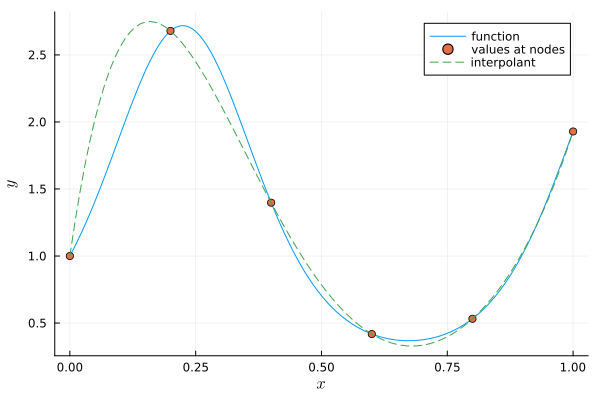

In [5]:
using Polynomials
p = Polynomial(c)
plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")
scatter!(t, y, label="values at nodes")
plot!(p, 0, 1, linestyle=:dash, label="interpolant")

OK, let's try a different $f$!

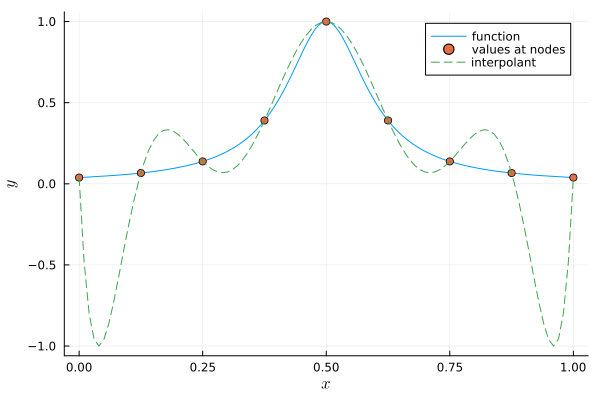

In [6]:
# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2) # Runge function
# f = x -> abs(exp(sin(7x)) - 1 ) # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function
plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")

n = 8;
t = range(0,1,n+1)
y = f.(t)

M = t .^ (0:n)' # the Vandermonde matrix
c = M \ y
p = Polynomial(c)

# c = vandermonde(t,f.(t))
# p = Polynomial(c)

scatter!(t, y, label="values at nodes")
plot!(p, 0, 1, linestyle=:dash, label="interpolant")

Can we look systematically at the error?

Start with the pointwise error:

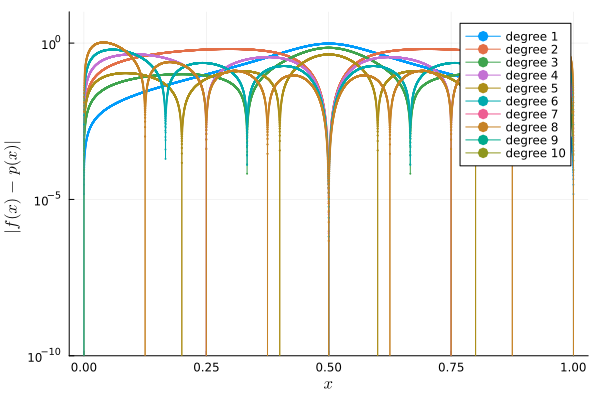

In [7]:
using LinearAlgebra
using BasicInterpolators

# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2)
# f = x -> abs(exp(sin(7x)) - 1)  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 1:10

plt = plot(label="", xaxis=(L"x"), yaxis=(:log10, L"|f(x)-p(x)|", [1e-10, 10]))

maxerr = zeros(length(n))
for (k,n) in enumerate(n)
    t = range(0,1,n+1)    # interpolation nodes
    c = vandermonde(t,f.(t))
    p = Polynomial(c)
    err = @. abs(f(x) - p(x))
    plot!(plt, x, err, m=(1, :o, stroke(0)), label="degree $n")
end
display(plt)

Now let's look at the maximum error on the domain, i.e., $\| f - p \|_\infty$

In [8]:
using LinearAlgebra
using BasicInterpolators

# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2)
# f = x -> abs(exp(sin(7x)) - 1  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 1:10
maxerr = zeros(length(n))
for (k, n) in enumerate(n)
    t = range(0,1,n+1)    # interpolation nodes
    c = vandermonde(t,f.(t))
    p = Polynomial(c)
    # f = s -> neville(s, t, f.(t)) # overflows; fix this later
    err = @. f(x) - p(x)
    maxerr[k] = norm(err, Inf) # find the largest-ish error in the domain 
end

In [9]:
maxerr

10-element Vector{Float64}:
   0.9615384615384616
   0.6462292487487395
   0.7070135746606331
   0.43835712189473114
   0.43269230769230593
   0.6169479236761022
   0.24735860655924824
   1.045176501879085
   0.30029774065800136
 NaN

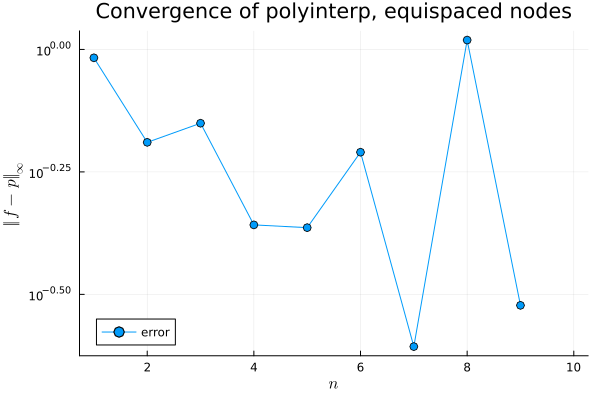

In [10]:
plot(n, maxerr, m=:o, label="error", xaxis=(L"n"),  yaxis=(:log10, L"\Vert f-p\, \Vert_\infty"),
    title="Convergence of polyinterp, equispaced nodes")

The maximum pointwise error in the domain does not converge very nicely! Can we do better?

Let's try **Chebyshev nodes**.

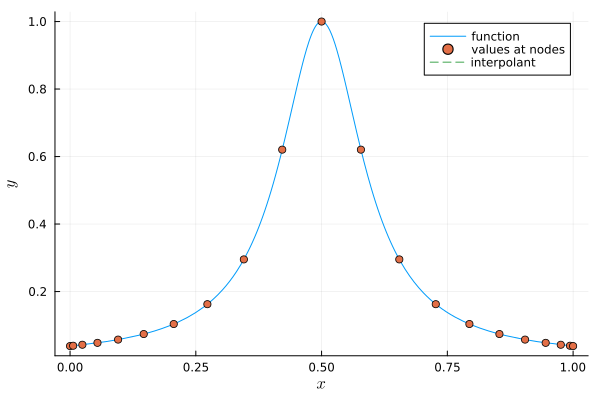

In [11]:
# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2)
# f = x -> abs(exp(sin(7x)) - 1)  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

n = 20; # polynomial degree
t = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes

# Do it by hand
c = vandermonde(t,f.(t))
p = Polynomial(c)

# Alternatively, use BasicInterpolators functionality
# p = ChebyshevInterpolator(f, 0, 1, n+1)

plot(f, 0, 1, label="function", xlabel=L"x", ylabel=L"y")
scatter!(t, f.(t), label="values at nodes")
plot!(x -> p(x), 0, 1, linestyle=:dash, label="interpolant")

Revisit the max error

In [12]:
# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2)
# f = x -> abs(exp(sin(7x)) - 1)  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 2:40                # polynomial degrees
maxerr = zeros(length(n))
for (k, n) in enumerate(n)
    p = ChebyshevInterpolator(f, 0, 1, n+1) 

    # Do it by hand: runs into ill-conditioning of the Vandermonde matrix!
    # t = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes
    # c = vandermonde(t,f.(t))
    # p = Polynomial(c)

    err = @. f(x) - p(x)
    maxerr[k] = norm(err, Inf) # find the largest-ish error in the domain 
end

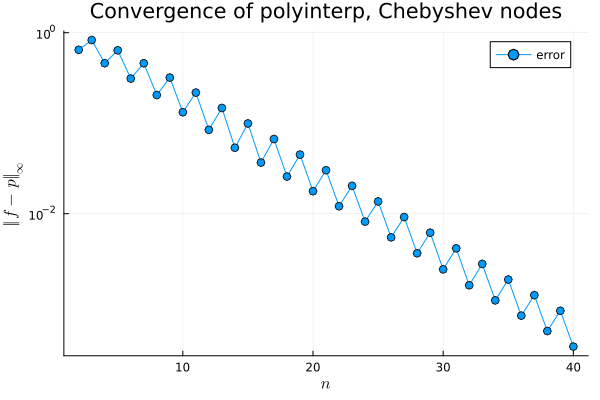

In [13]:
plot(n, maxerr, m=:o, label="error", xaxis=(L"n"),  yaxis=(:log10, L"\Vert f-p\, \Vert_\infty"),
    title="Convergence of polyinterp, Chebyshev nodes")
# plot!(n, 1 ./ n)

For the Runge function, the error looks linear on a log-linear scale! The error is thus of the form $$ e := \|f - p \|_\infty \leq C k^{-n},$$ for some constants $C, k > 0$ and the polynomial degree $n$. Thus $\log e = \log C - n \log k$. This is known as _spectral_ or _exponential_ convergence: a constant factor ($k$) reduction in the error with each increment of $n$. Contrast this behavior with what we observed earlier: _algebraic convergence_, where $e = \mathcal{O}(h^{-\alpha})$ for some grid spacing $h$ and exponent $\alpha > 0$. Algebraic convergence is much slower. Algebraic convergence yields linear error plots on a log-log scale, while spectral convergence yields linear error plots on a log-linear scale.

Chebyshev interpolation yields algebraic convergence only for very smooth functions, specifically what are called _real analytic functions_. A necessary (but not sufficient) condition for real analyticity is that the function be infinitely differentiable.

The function with kinks (see above) is continuous but does not have a continuous derivative (i.e., it is not $C^1$), and thus we only see algebraic convergence of order 1. 

Chebyshev polynomial interpolation of the exp-sin function (see above) actually converges faster than exponential, because it is entire. You can see this if you run the script above to very high degree.

## Ill-conditioning of Vandermonde matrix

In addition to avoiding equispaced points, it turns out that there is another pitfall to avoid with high-degree polynomials: **the monomial basis is bad**, and in particular the **monomial Vandermonde matrix is nearly singular ("ill-conditioned")**, which makes it **susceptible to catastrophic roundoff error**.

This means that, *even if we use "good" Chebyshev points*, if we naively use the Vandermonde matrix, the interpolation gets *exponentially worse* at some point due to the growing roundoff errors.

The example above didn't display this phenomenon because it used a library function `ChebyshevInterpolator` that cleverly avoids the monomial basis, instead using a **different basis of polynomials**: an "orthogonal" basis called [Chebyshev polynomials](https://en.wikipedia.org/wiki/Chebyshev_polynomials) (that turn out to be very nice because they are "cosines in disguise").

Here is what happens, with the same "Runge function" $f(x) = \frac{1}{1 + 100(x-0.5)^2}$ and the same non-equispaced Chebyshev points, if we had tried to express the interpolating polynomial $p(x)$ in the monomial basis $c_0 + c_1 x + \cdots c_n x^n$ via the Vandermonde matrix:

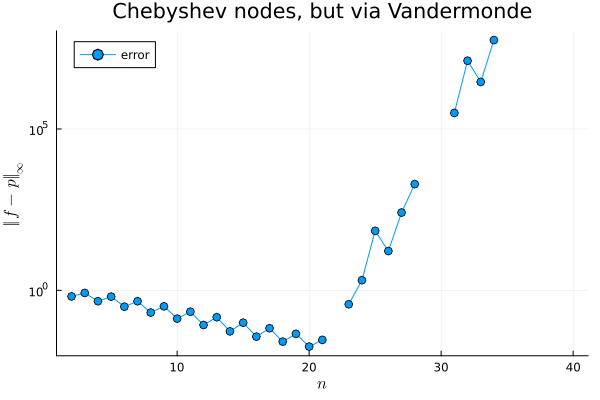

In [14]:
# f = x -> exp(sin(7x))
f = x -> 1 / (1 + 100(x - 0.5)^2)
# f = x -> abs(exp(sin(7x)) - 1)  # a funny function with kinks
# f = x -> ( x < 0.5 ? 0.0 : (x > 0.5 ? 1.0 : 0.5) )  # Heaviside function

x = range(0, 1, 10001)  # evaluate f(x) - p(x) at many points
n = 2:40                # polynomial degrees
maxerr = zeros(length(n))
for (k, n) in enumerate(n)
    # p = ChebyshevInterpolator(f, 0, 1, n+1) 

    # Do it by hand: runs into ill-conditioning of the Vandermonde matrix!
    t = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes
    c = vandermonde(t,f.(t))
    p = Polynomial(c)

    err = @. f(x) - p(x)
    maxerr[k] = norm(err, Inf) # find the largest-ish error in the domain 
end

plot(n, maxerr, m=:o, label="error", xaxis=(L"n"),  yaxis=(:log10, L"\Vert f-p \, \Vert_\infty"),
    title="Chebyshev nodes, but via Vandermonde")

You can see that the error **grows exponentially** as a function of $n$ beyond $n \approx 20$, which is due to an explosion of roundoff errors thanks to the near singularity of the Vandermonde matrix.

It is easy to see why the Vandermonde matrix becomes nearly singular, because the polynomials $x^k$ on $x \in [0,1]$ approach
$$
\begin{pmatrix} x_0^k = 0^k \\ x_1^k \\ \vdots \\ x_n^k = 1^k \end{pmatrix} \to \begin{pmatrix} 0 \\ 0 \\ \vdots \\ 0 \\ 1 \end{pmatrix}
$$
as $k$ grows ($x^k \to 0$ except at $x=1$).

That is **the last few columns become nearly parallel**, which is a sign of a **nearly singular matrix** (if the columns were *exactly* parallel it would be exactly singular).

Let's plot the columns for $n=25$ to see this:

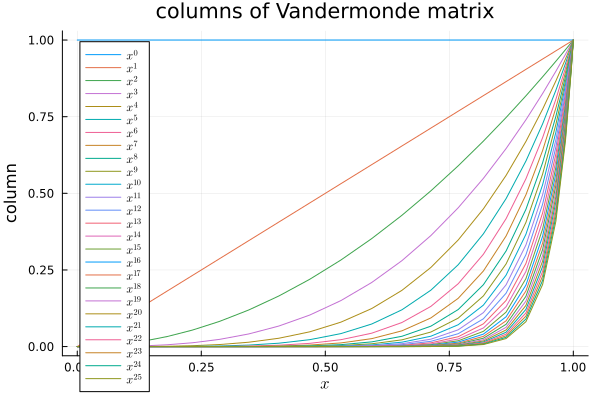

In [15]:
n = 25
x = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes
V = x .^ (0:n)' # Vandermonde matrix

plot(title="columns of Vandermonde matrix", xlabel="\$x\$", ylabel="column")
for k = 0:n
    plot!(x, V[:, k+1], label="\$ x ^ {$k} \$")
end
plot!()

The "nearly singular" is *quantified* using the [condition number](https://en.wikipedia.org/wiki/Condition_number) of the matrix:
$$
\kappa(A) = \Vert A \Vert \, \Vert A^{-1} \Vert = \kappa(A^{-1})
$$
where $\Vert A \Vert$ is an [induced norm](https://en.wikipedia.org/wiki/Operator_norm):
$$
\Vert A \Vert = \sup_{x \ne 0} \frac{\Vert A x \Vert}{\Vert x \Vert}
$$
measuring "how big" a matrix is by the maximum amount it can stretch a vector.

It turns out that the worst-case growth of roundoff errors when computing either $Ax$ or $A^{-1} x$ is proportional to $\kappa(A)$, the condition number.  So a matrix that is nearly singular ($\Vert A^{-1} \Vert$ is big compared to $1/\Vert A \Vert$) will have large growth of roundoff errors.

The Vandermonde matrix is nearly singular, and it turns out that its condition number grows *exponentially* with $n$.  In Julia (and in most other linear algebra libraries, e.g. Matlab or NumPy), the condition number (in the L2 norm) is computed by `cond(A)`.  Let's plot the condition number of the Vandermonde matrix as a function of $n$:

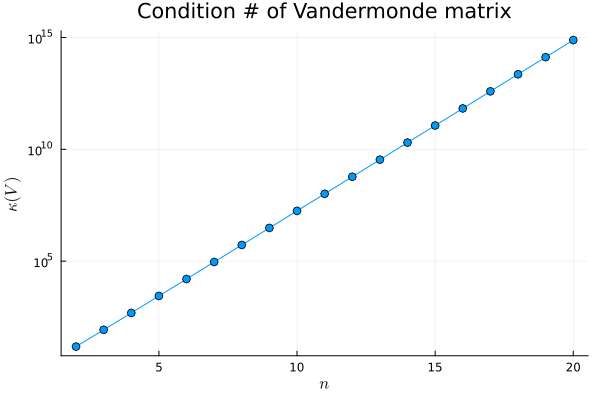

In [16]:
using LinearAlgebra

n = 2:20
κ = map(n) do n
    x = chebygrid(0, 1, n+1) # n+1 Chebyshev nodes
    V = x .^ (0:n)' # Vandermonde matrix
    cond(V)
end

plot(n, κ, marker=:o, yaxis=:log10, title="Condition # of Vandermonde matrix", label=false, ylabel=L"\kappa(V)", xlabel=L"n")

By about $n\approx 20$, the condition number is $\approx 10^{15}$, so that that point in `Float64` arithmetic our roundoff errors have exploded to the point that they have begun to wipe out all of our correct digits, and correspondingly the interpolation error starts to *increase* around that point.

The solution is not to use monomial coefficients to express polynomials at high degrees.

# Aside: basis functions for polynomial interpolation

We don't need to use the monomial basis; in fact it is much better not to! We will get into this later: different polynomial bases---for the _same_ polynomial space---can yield much a better conditioned Vandermonde matrix and better conditioning in general.

One seemingly attractive basis is the Lagrange polynomials defined by a set of nodes. Numerically, these are actually unstable, but they can be useful for theory and are a global polynomial analog of the "hat functions" we saw in the last lecture.

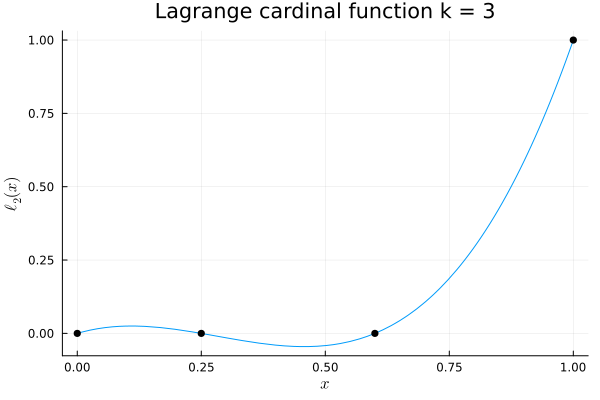

In [17]:
t = [ 0, 0.25, 0.6, 1.0 ]   # some nodal set
n = length(t) - 1;          # poly degree = number of nodes minus one

k = 3                      # pick one basis function
q(x) = prod(x - t[i] for i in [0:k-1; k+1:n] .+ 1)
ℓₖ(x) = q(x) / q(t[k+1]);

plot(ℓₖ, 0, 1, label=false)
y = zeros(n+1);  y[k+1] = 1
scatter!(t, y, color=:black,
    xaxis=(L"x"),  yaxis=(L"\ell_2(x)"),
    title="Lagrange cardinal function k = $k", label=false)